# find the face areas for the Prosopagnosia study

this scripts automizes the way of finding individual subjects peak coordinates for face areas (e.g. FFA, ATL), defines and saves anatomical masks for later usages, and vizualizes the stability and variability of single subject activation in an emotional faces paradigm (contrast faces > houses)

Our aims were to find a "group mask" for the anterior temporal face area (ATL). Usually, face areas get defined functionally, via a localizer. However, our localizer could only identify more prominent face areas such as the fusiform face area (FFA). For ATL we get some rather smaller/weaker clusters, that may be convenient as group peak. Therefore we decided to search for an anatomical mask.




In [3]:
from __future__ import division
import os
from glob import glob
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import pandas as pd

plotDir = 'C:/Users/Roman/Desktop/Projects/Prosopagnosia/plots/'
maskDir = 'C:/Users/Roman/Desktop/Projects/Prosopagnosia/masks/romans_composition/'
if not os.path.isdir(plotDir): os.makedirs(plotDir)
if not os.path.isdir(maskDir): os.makedirs(maskDir)


In [4]:
# import atlas
from nilearn.datasets import fetch_atlas_harvard_oxford
from nilearn import plotting, image


C:\Users\Roman\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [5]:
atlas = fetch_atlas_harvard_oxford(atlas_name = 'cort-prob-2mm', symmetric_split = False) # symm split only works for subcortical
atlas_filename = atlas.maps

Here are some possible probabilistic (anatomic) atlases, that we could use to find each subjects individual FFA / ATL in. It is by the Harvard Oxford atlas, that is often used by FSL software.

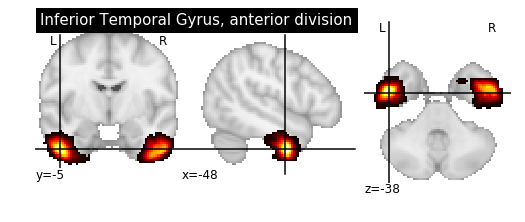

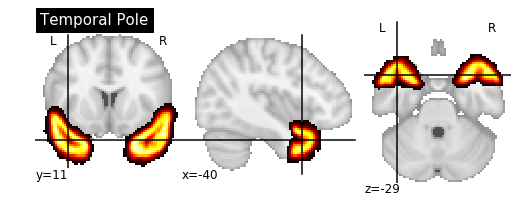

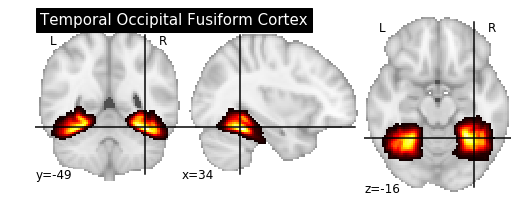

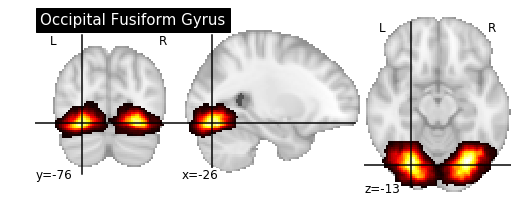

In [6]:
display = plotting.plot_stat_map(image.index_img(atlas_filename,13),
                                 colorbar=False,
                                 title=atlas.labels[13+1])
plotting.show()
display = plotting.plot_stat_map(image.index_img(atlas_filename,7),
                                 colorbar=False,
                                 title=atlas.labels[7+1])
plotting.show()

display = plotting.plot_stat_map(image.index_img(atlas_filename,38),
                                 colorbar=False,
                                 title=atlas.labels[38+1])
plotting.show()
display = plotting.plot_stat_map(image.index_img(atlas_filename,39),
                                 colorbar=False,
                                 title=atlas.labels[39+1])
plotting.show()
#display.add_overlay(image.index_img(fourDfileName, 6),
#                    cmap=plotting.cm.black_green)
#display.add_overlay(image.index_img(fourDfileName, 3),
#                    cmap=plotting.cm.black_pink)



I would use the "Temporal Occipital Fusiform Gyrus" mask to find each subject's FFA(s), and one of the upper masks ("inferior Temporal Gyrus, anterior devision", or "temporal pole").


in the following two images, I have located the crosshair to the coordinate of our second level peak voxel, and it is quite nicely located within our anatomical mask.

Therefore, we go on with this (probabilistic) anatomical mask for FFA.

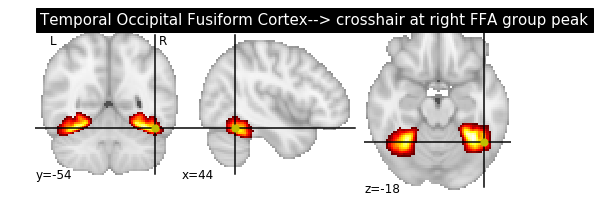

In [7]:
display = plotting.plot_stat_map(image.index_img(atlas_filename,38),
                                 colorbar=False,
                                 title=atlas.labels[38+1] + "--> crosshair at right FFA group peak",
                                 threshold = 10,
                                 cut_coords = (44, -54, -18)
                                 )
coords = [(44 , -54,  -18)]
display.add_markers(coords, marker_color='y', marker_size=50)
plotting.show()

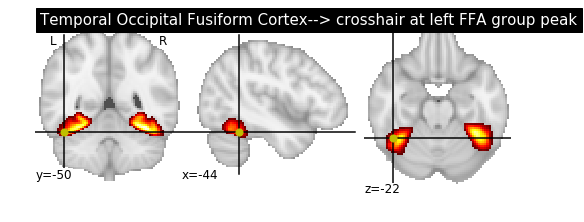

In [8]:
display = plotting.plot_stat_map(image.index_img(atlas_filename,38),
                                 colorbar=False,
                                 title=atlas.labels[38+1] + "--> crosshair at left FFA group peak",
                                 threshold = 10,
                                 cut_coords = (-44 , -50,  -22),
                                 )
coords = [(-44 , -50,  -22)]
display.add_markers(coords, marker_color='y', marker_size=50)
plotting.show()

# here plot all masks of the atlas just to have an overview what is present


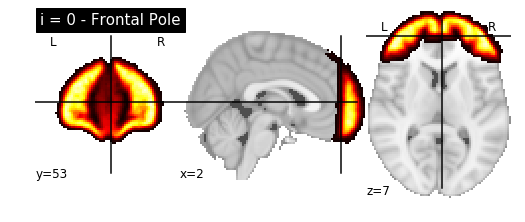

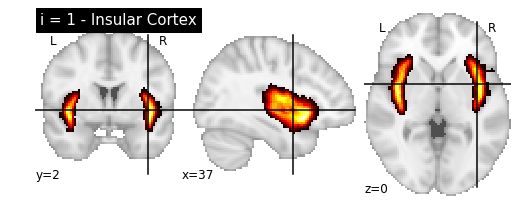

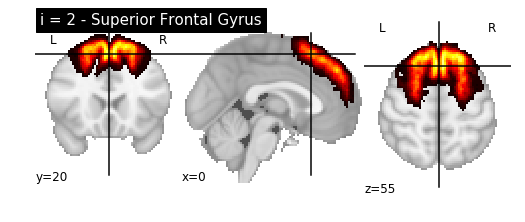

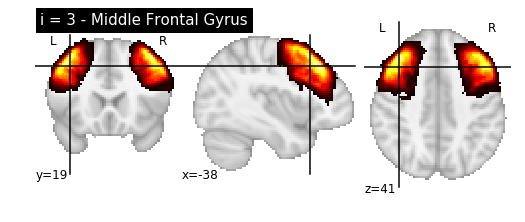

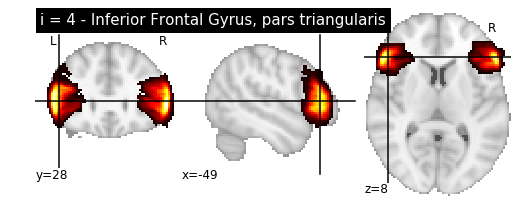

...

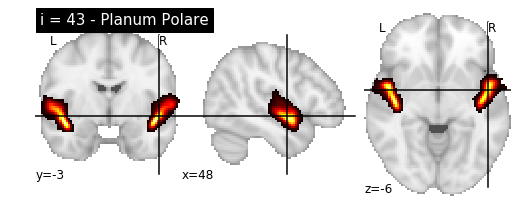

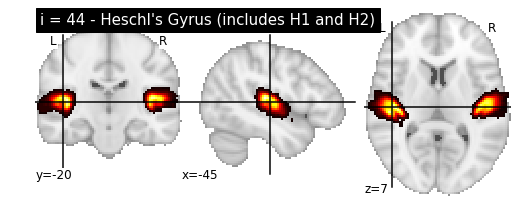

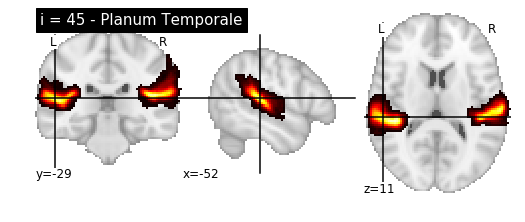

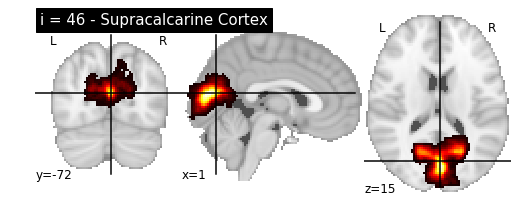

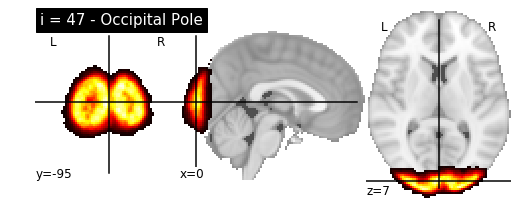

In [9]:
for i in range(len(atlas.labels) - 1):
    display = plotting.plot_stat_map(image.index_img(atlas_filename,i),
                                     colorbar=False,
                                     title= 'i = ' + str(i) + ' - ' + atlas.labels[i+1])
    plotting.show()
    plt.close()

now show the literature coordinates for ATL (and FFA and OFA) to decide for an apropriate ATL mask:

--> to do: literature references and criteria for selection of respective reference, for all peaks (Paula?)

In [10]:
coordsLiteraturerATL = [[ 31,  5,  -42 ], [42,  8,  -37], [41,  -4,  -35]]
coordsLiteraturelATL = [[ -33,  2,  -35], [-39,  9,  -41], [-57, -16, -29]]
allCoordsLiteratureATL = coordsLiteraturerATL + coordsLiteraturelATL

coordsLiteraturerFFA = [[35, -52, -18], [35, -47, -26], [44, -48, -22], [42, -43, -24]]
coordsLiteraturelFFA = [[-39, -41, -23], [-43, -47, -22], [-41, -48, -24], [-40, -41, -24]]
allCoordsLiteratureFFA = coordsLiteraturerFFA + coordsLiteraturelFFA

coordsLiteraturerOFA = [[42,-84,-5],[42,-82,-11],[52,-74,-6],[40,-79,-12],[50,-82,-6],[44,-74,-8],[49,-82,-4],[34,-89,-5],[44,-82,-4],[42,-84,-5],[47,-65,-21],[43,-81,-10]]
coordsLiteraturelOFA = [[-35,-86,-12]]
allCoordsLiteratureOFA = coordsLiteraturerOFA + coordsLiteraturelOFA

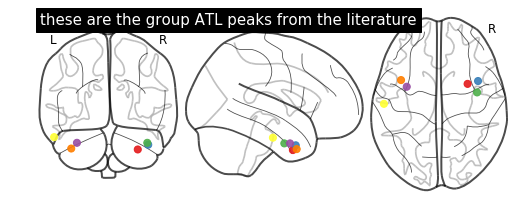

In [11]:
view = plotting.plot_connectome(adjacency_matrix=np.zeros((6,6)), # zero matrix, because we have no connectivities
                                            node_coords=allCoordsLiteratureATL,
                                            node_color =plt.cm.datad['Set1']['listed'],
                                            node_size = 50,
                                            node_kwargs = {'alpha': 0.9},
                                            title = 'these are the group ATL peaks from the literature'#subject + ' ' + region
                                           )
plt.show()
plt.close()

C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py

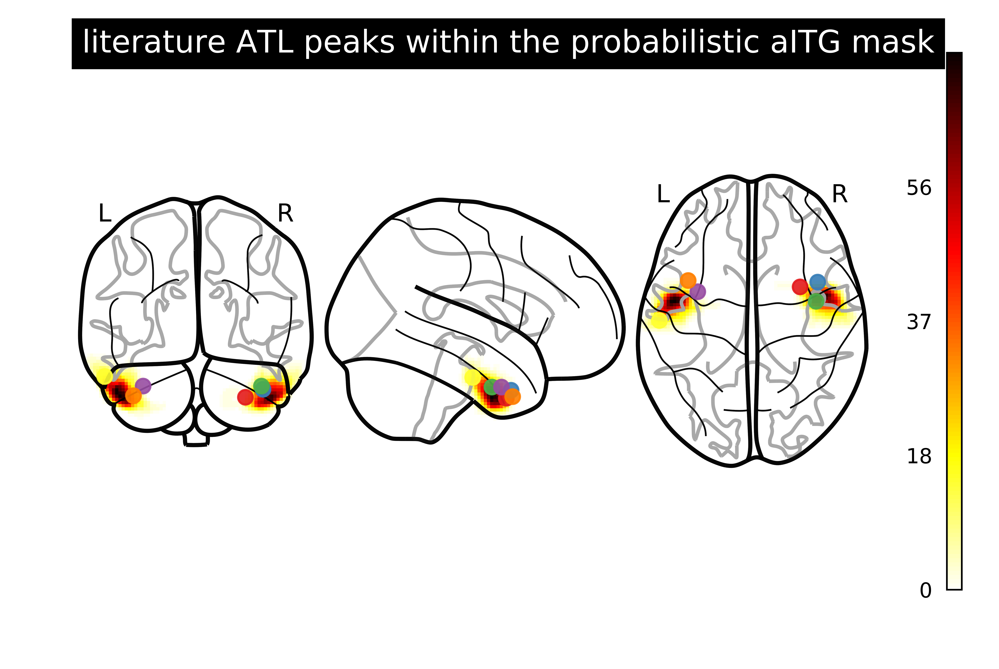

In [12]:
f = plt.figure(dpi=1000)

view = plotting.plot_connectome(adjacency_matrix=np.zeros((6,6)), # zero matrix, because we have no connectivities
                                            node_coords=allCoordsLiteratureATL,
                                            node_color =plt.cm.datad['Set1']['listed'],
                                            node_size = 50,
                                            node_kwargs = {'alpha': 0.9},
                                            title = 'literature ATL peaks within the probabilistic aITG mask', #subject + ' ' + region
                                            figure = f
                                           )

plotting.plot_glass_brain(image.index_img(atlas_filename,13),
                                   output_file=None,
                                   display_mode='ortho',
                                   colorbar=True,
                                   figure=f,
                                   axes=None,
                                   title=None,
                                   threshold='auto',
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=0.9,
                                   vmin=None,
                                   vmax=None,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py

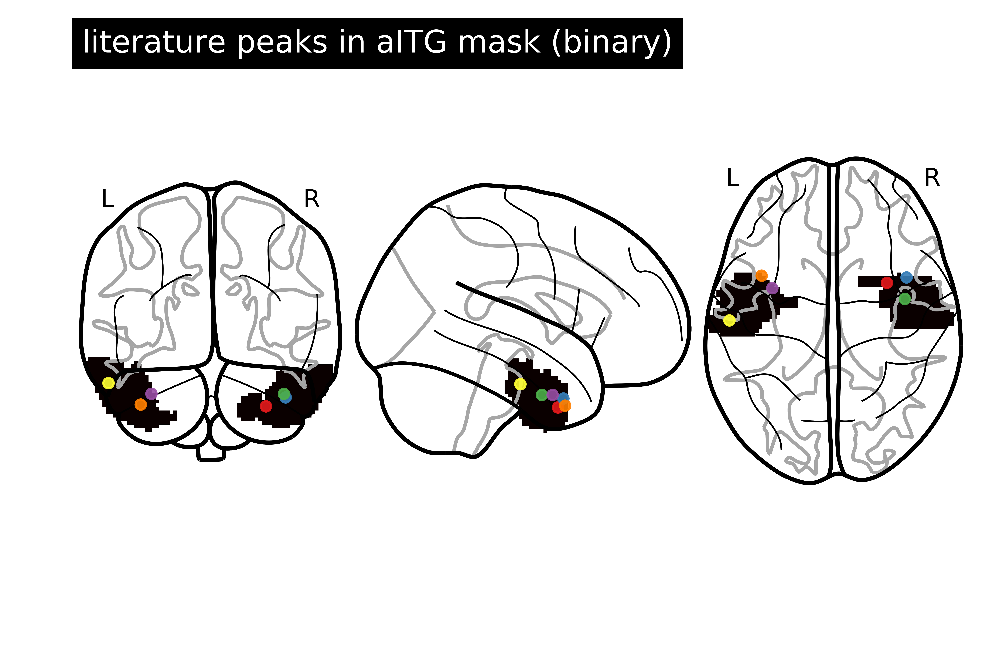

In [14]:
f = plt.figure(dpi=1000)

view = plotting.plot_connectome(adjacency_matrix=np.zeros((6,6)), # zero matrix, because we have no connectivities
                                            node_coords=allCoordsLiteratureATL,
                                            display_mode='ortho',
                                            #cut_coords = list(range(-30,-10)),
                                            node_color =plt.cm.datad['Set1']['listed'],
                                            node_size = 25,
                                            node_kwargs = {'alpha': 0.9},
                                            title = 'literature peaks in aITG mask (binary)', #subject + ' ' + region
                                            figure = f
                                           )

plotting.plot_glass_brain(image.index_img(atlas_filename,13),
                                   output_file=None,
                                   display_mode='ortho',
                                   #cut_coords = list(range(-30,-10)),
                                   colorbar=False,
                                   figure=f,
                                   axes=None,
                                   title=None,
                                   threshold=0,# 'auto',
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   vmin=1,
                                   vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

so we can see, that aITG highly overlaps with the literature peaks for the anterior temporal lobe face area (ATL). However, some peaks are still in areas of "low probability". Therefore, we will have a look at the other anatomical masks in the atlas, that may be suitable. 

C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py

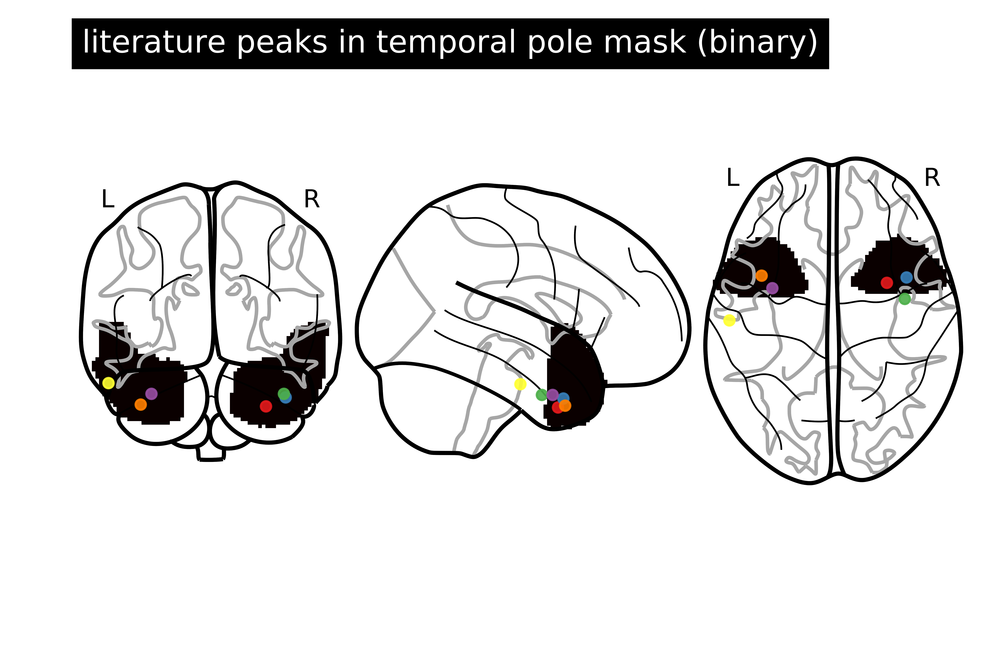

In [13]:
f = plt.figure(dpi=1000)

view = plotting.plot_connectome(adjacency_matrix=np.zeros((6,6)), # zero matrix, because we have no connectivities
                                            node_coords=allCoordsLiteratureATL,
                                            display_mode='ortho',
                                            #cut_coords = list(range(-30,-10)),
                                            node_color =plt.cm.datad['Set1']['listed'],
                                            node_size = 25,
                                            node_kwargs = {'alpha': 0.9},
                                            title = 'literature peaks in temporal pole mask (binary)', #subject + ' ' + region
                                            figure = f
                                           )

plotting.plot_glass_brain(image.index_img(atlas_filename,7),
                                   output_file=None,
                                   display_mode='ortho',
                                   #cut_coords = list(range(-30,-10)),
                                   colorbar=False,
                                   figure=f,
                                   axes=None,
                                   title=None,
                                   threshold=1,# 'auto',
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   vmin=1,
                                   vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

the anterior temporal pole seems to be a convenient extenction to aITG as a probable region for anterior temporal face areas. However, the mask still exceeds into superior (and slightly posterior) direction. Therefore we will need to cut some parts out of it (see later). 

literature peaks in FFA masks

C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py

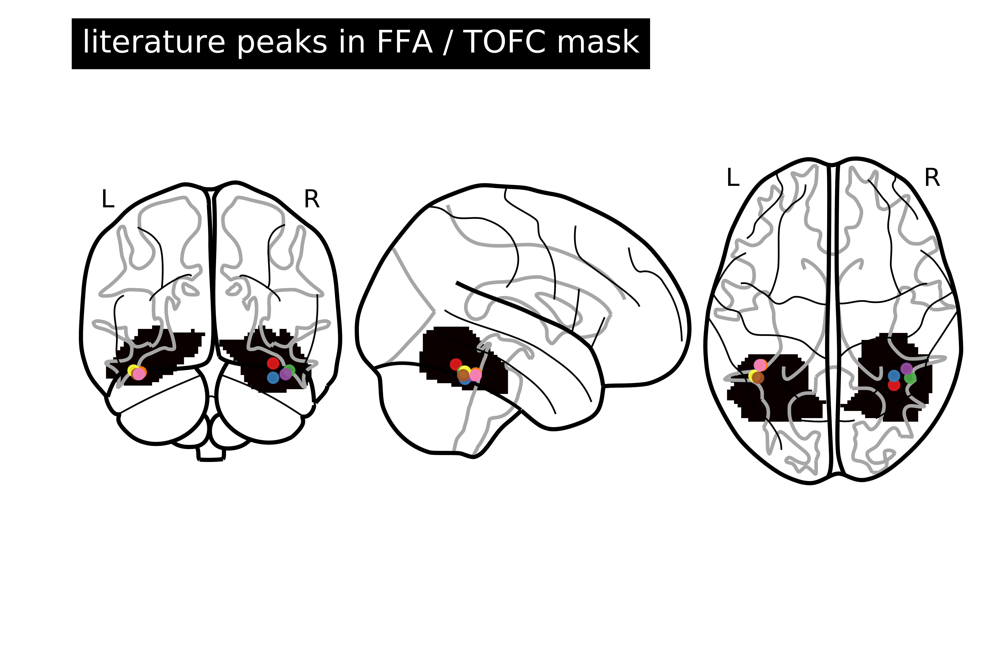

In [16]:
f = plt.figure(dpi=1000)

view = plotting.plot_connectome(adjacency_matrix=np.zeros((8,8)), # zero matrix, because we have no connectivities
                                            node_coords=allCoordsLiteratureFFA,
                                            display_mode='ortho',
                                            #cut_coords = list(range(-30,-10)),
                                            node_color =plt.cm.datad['Set1']['listed'],
                                            node_size = 25,
                                            node_kwargs = {'alpha': 0.9},
                                            title = 'literature peaks in FFA / TOFC mask', #subject + ' ' + region
                                            figure = f
                                           )

plotting.plot_glass_brain(image.index_img(atlas_filename,38),
                                   output_file=None,
                                   display_mode='ortho',
                                   #cut_coords = list(range(-30,-10)),
                                   colorbar=False,
                                   figure=f,
                                   axes=None,
                                   title=None,
                                   threshold=0.1,# 'auto',
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   vmin=1,
                                   vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

for the OFA

C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py

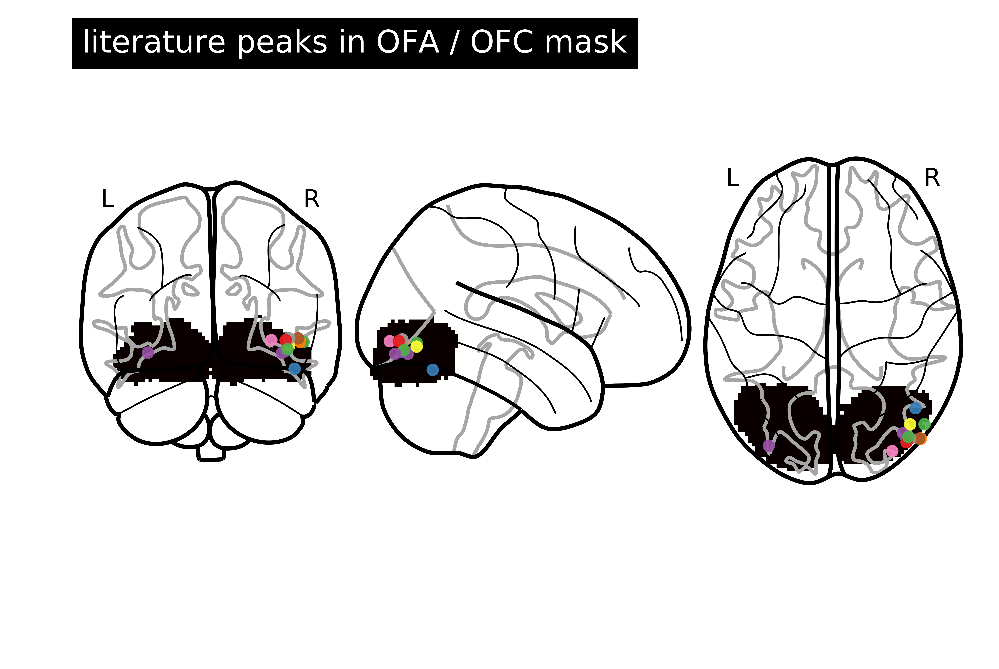

In [17]:
f = plt.figure(dpi=1000)

view = plotting.plot_connectome(adjacency_matrix=np.zeros((len(allCoordsLiteratureOFA),len(allCoordsLiteratureOFA))), # zero matrix, because we have no connectivities
                                            node_coords=allCoordsLiteratureOFA,
                                            display_mode='ortho',
                                            #cut_coords = list(range(-30,-10)),
                                            node_color =plt.cm.datad['Set1']['listed'],
                                            node_size = 25,
                                            node_kwargs = {'alpha': 0.9},
                                            title = 'literature peaks in OFA / OFC mask', #subject + ' ' + region
                                            figure = f
                                           )

plotting.plot_glass_brain(image.index_img(atlas_filename,39),
                                   output_file=None,
                                   display_mode='ortho',
                                   #cut_coords = list(range(-30,-10)),
                                   colorbar=False,
                                   figure=f,
                                   axes=None,
                                   title=None,
                                   threshold='auto',
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   vmin=1,
                                   vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
C:\Users\Roman\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py

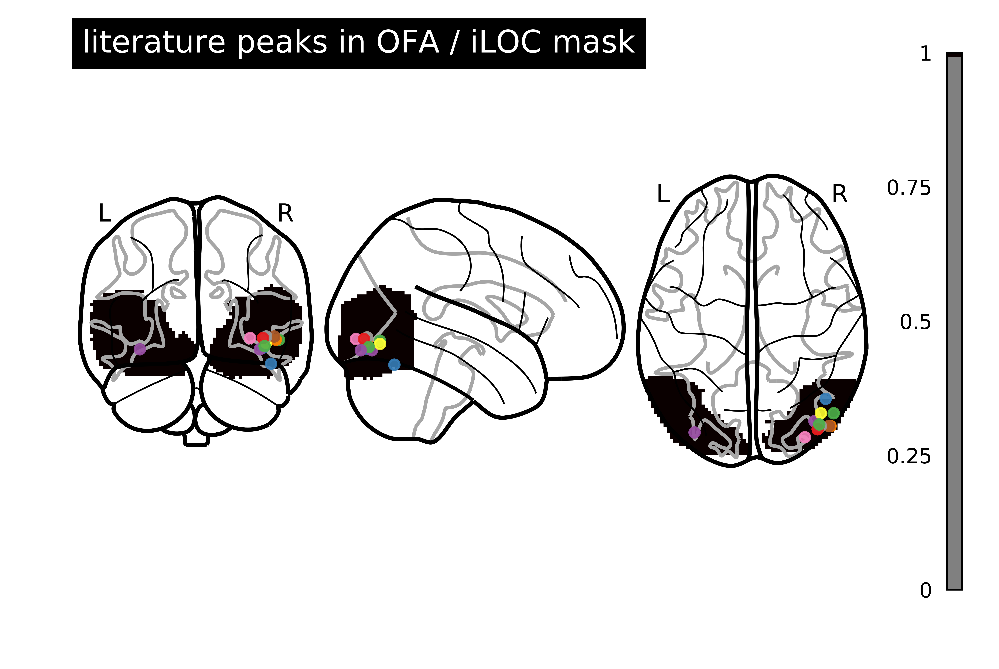

In [18]:
f = plt.figure(dpi=1000)

view = plotting.plot_connectome(adjacency_matrix=np.zeros((len(allCoordsLiteratureOFA),len(allCoordsLiteratureOFA))), # zero matrix, because we have no connectivities
                                            node_coords=allCoordsLiteratureOFA,
                                            display_mode='ortho',
                                            #cut_coords = list(range(-30,-10)),
                                            node_color =plt.cm.datad['Set1']['listed'],
                                            node_size = 25,
                                            node_kwargs = {'alpha': 0.9},
                                            title = 'literature peaks in OFA / iLOC mask', #subject + ' ' + region
                                            figure = f
                                           )

plotting.plot_glass_brain(image.index_img(atlas_filename,22),
                                   output_file=None,
                                   display_mode='ortho',
                                   #cut_coords = list(range(-30,-10)),
                                   colorbar=True,
                                   figure=f,
                                   axes=None,
                                   title=None,
                                   threshold=1,#'auto',
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   vmin=1,
                                   vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

the OFA mask is not good yet.

It is quite hard to find an apropriate anatomical mask for OFA.

This needs more literature research.

We drop OFA here. We don't need it for our analyses at this point.

# amygdalae

the amygdala is easily defined anatomically (contrary to FFA /OFA/ATL, which are usually defined functionally).

therefore we use the subcortical atlas of Harvard/Oxford

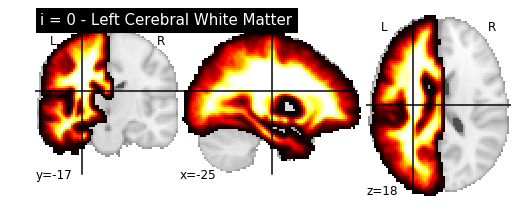

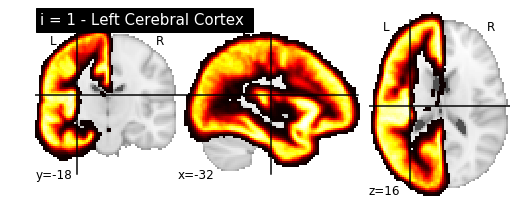

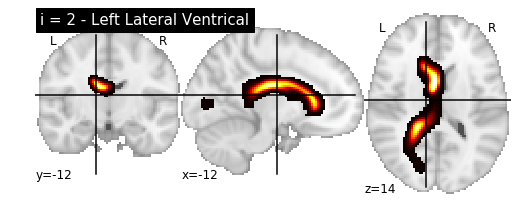

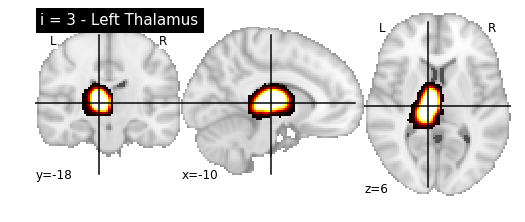

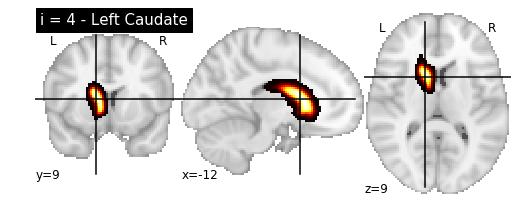

...

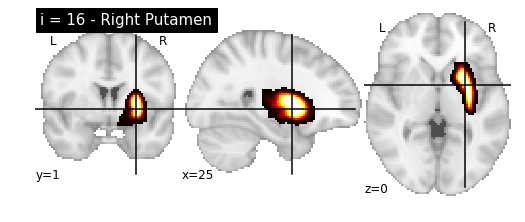

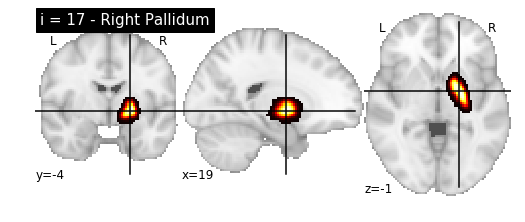

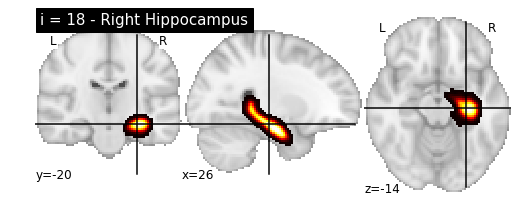

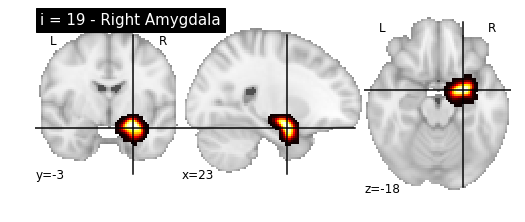

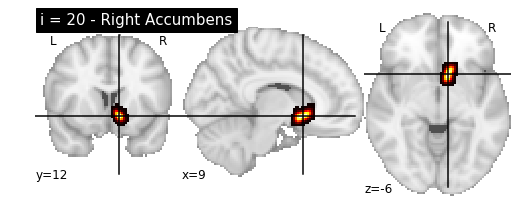

In [17]:
atlasSubcortical = fetch_atlas_harvard_oxford(atlas_name = 'sub-prob-2mm', symmetric_split = False) # symm split only works for subcortical
atlasSubcortical_filename = atlasSubcortical.maps

# plot all regions
for i in range(len(atlasSubcortical.labels) - 1):
    display = plotting.plot_stat_map(image.index_img(atlasSubcortical_filename,i),
                                     colorbar=False,
                                     title= 'i = ' + str(i) + ' - ' + atlasSubcortical.labels[i+1])
    plotting.show()
    plt.close()



here are shown all the different "subcortical" regions in the atlas

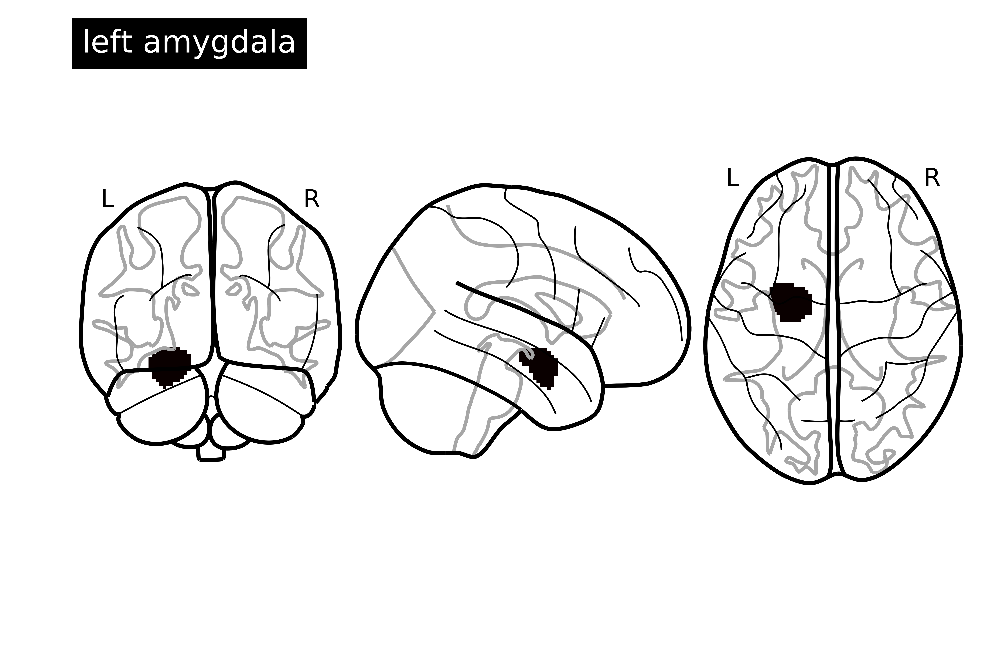

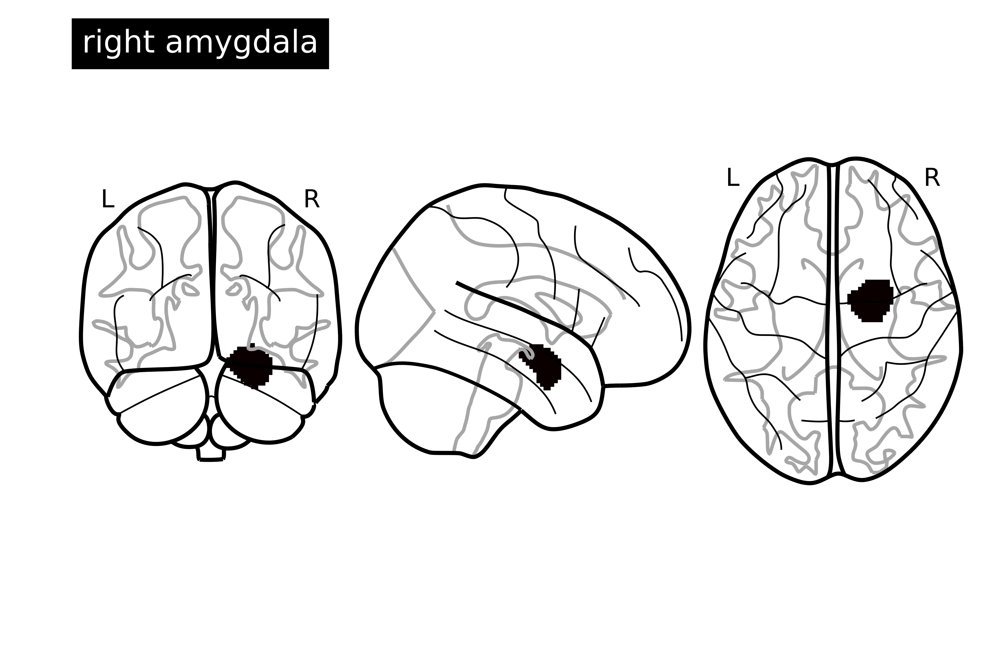

In [18]:
# only amygdalye

f = plt.figure(dpi=1000)
plotting.plot_glass_brain(image.index_img(atlasSubcortical_filename,9),
                                   #output_file=plotDir + 'lAmyg.png',
                                   display_mode='ortho',
                                   colorbar=False,
                                   figure=f,
                                   axes=None,
                                   title='left amygdala',
                                   threshold=10,#'auto', ##### careful: I chose a threshold of 20 here
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   vmin=1,
                                   vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

f = plt.figure(dpi=1000)
plotting.plot_glass_brain(image.index_img(atlasSubcortical_filename,19),
                                   #output_file=plotDir + 'rAmyg.png',
                                   display_mode='ortho',
                                   colorbar=False,
                                   figure=f,
                                   axes=None,
                                   title='right amygdala',
                                   threshold=10,#'auto', ##### careful: I chose a threshold of 20 here
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   vmin=1,
                                   vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

the probabilistic amygdala masks are thresholded at a particular threshold (e.g. 20 % probability of being amygdala) and saved for later usage 

In [25]:
# save masks as .nii
from nilearn.masking import intersect_masks

# this makes probabilistic images
lAmyMask = image.index_img(atlasSubcortical_filename,9)
rAmyMask = image.index_img(atlasSubcortical_filename,19)

# convert to binary
from nilearn.image import load_img, math_img
lAmyMaskBinary = math_img('img > 20', img=lAmyMask)
rAmyMaskBinary = math_img('img > 20', img=rAmyMask)
amyMaskBinary = intersect_masks([lAmyMaskBinary, rAmyMaskBinary], threshold=0, connected=False)
# save images
lAmyMaskBinary.to_filename(maskDir + 'lAmy.nii')
rAmyMaskBinary.to_filename(maskDir + 'rAmy.nii')


# create a right and left hemisphere mask

because most masks in the atlas are bihemispheric (i.e. both right and left homologues are within one dimension of the mask), we create a mask for each hemisphere, to multiply it with the bihemispheric regions of interest to create unihemispheric (i.e. right or left) masks.

In [26]:
### left hemisphere ###

# this makes probabilistic images
lWMMask = image.index_img(atlasSubcortical_filename,0)
lGMMask = image.index_img(atlasSubcortical_filename,1)

# convert to binary
from nilearn.image import load_img, math_img
lWMMask = math_img('img > 1', img=lWMMask)
lGMMask = math_img('img > 1', img=lGMMask)

# save images
lWMMask.to_filename(maskDir + 'lWM.nii')
lGMMask.to_filename(maskDir + 'lGM.nii')

# intersect / union the both masks
from nilearn.masking import intersect_masks
lHemMask = intersect_masks(mask_imgs = [lWMMask,lGMMask],
                            threshold=0, # threshold = 0 is the union of all masks
                            connected=True)
lHemMask.to_filename(maskDir + 'lHemMask.nii')


### right hemisphere ###

# this makes probabilistic images
rWMMask = image.index_img(atlasSubcortical_filename,11)
rGMMask = image.index_img(atlasSubcortical_filename,12)

# convert to binary
from nilearn.image import load_img, math_img
rWMMask = math_img('img > 1', img=rWMMask)
rGMMask = math_img('img > 1', img=rGMMask)

# save images
rWMMask.to_filename(maskDir + 'rWM.nii')
rGMMask.to_filename(maskDir + 'rGM.nii')

# intersect / union the both masks
rHemMask = intersect_masks(mask_imgs = [rWMMask,rGMMask],
                            threshold=0, # threshold = 0 is the union of all masks
                            connected=True)
rHemMask.to_filename(maskDir + 'rHemMask.nii')


# calculate the individual masks

In [56]:
# this makes probabilistic images
TOFCmask = image.index_img(atlas_filename,38)
aSTGmask = image.index_img(atlas_filename,8)
pSTGmask = image.index_img(atlas_filename,9)
OFCmask  = image.index_img(atlas_filename,39)
iLOCmask = image.index_img(atlas_filename,22)
aITGmask = image.index_img(atlas_filename,13)
TPmask   = image.index_img(atlas_filename,7)

# convert to binary
from nilearn.image import load_img, math_img
TOFCmask = math_img('img > 10', img=TOFCmask) # before that, the threshold was ">1" for all images
aSTGmask = math_img('img > 10', img=aSTGmask)
pSTGmask = math_img('img > 10', img=pSTGmask)
OFCmask = math_img('img > 10', img=OFCmask)
iLOCmask = math_img('img > 10', img=iLOCmask)
aITGmask1percent = math_img('img > 0', img=aITGmask) # also a special version with low threshold for the aIT
aITGmask = math_img('img > 10', img=aITGmask)
TPmask = math_img('img > 10', img=TPmask)

# make the negative of some masks
#neg_aSTGmask = math_img('(img * -1) + 1', img=aSTGmask)
#neg_pSTGmask = math_img('(img * -1) + 1', img=pSTGmask)



## FFA = TOFC minus STG

because the TOFC mask exceedes to quite superior regions, and those regions may belong to other face areas but FFA (e.g. pSTS face area), we use the STG mask to exclude those superior regions from our TOFC mask and derive our "FFA mask"

In [28]:
FFAmask = math_img(formula = '( TOFC - pSTG ) > 0', #[TOFCmask,neg_pSTGmask],
                        TOFC = TOFCmask,
                        pSTG = pSTGmask)
                   #threshold=1, # threshold = 0 is the union of all masks, threshold = 1 is the intercection

rFFAmask = intersect_masks([FFAmask, rHemMask], threshold = 1)
lFFAmask = intersect_masks([FFAmask, lHemMask], threshold = 1)

rFFAmask.to_filename(maskDir + 'rFFA.nii')
lFFAmask.to_filename(maskDir + 'lFFA.nii')
FFAmask.to_filename(maskDir + 'FFA.nii')

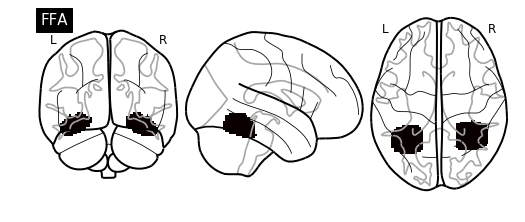

In [29]:
# plot
plotting.plot_glass_brain(FFAmask,
                                   #output_file=plotDir + 'rAmyg.png',
                                   display_mode='ortho',
                                   colorbar=False,
                                   #figure=f,
                                   axes=None,
                                   title='FFA',
                                   threshold='auto',#'auto', ##### careful: I chose a threshold of 20 here
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   #vmin=0,
                                   #vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

## OFA = OFC intercept with iLOC minus pSTG

OFA is still difficult to define anatomically, skip it for now

In [30]:
OFAmask = math_img(formula = '( ( (iLOC + OFC) > 1 ) - STG ) > 0',
                    iLOC = iLOCmask, # threshold = 0 is the union of all masks, threshold = 1 is the intercection
                    OFC = OFCmask,
                    STG = pSTGmask)

rOFAmask = intersect_masks([OFAmask, rHemMask], threshold = 1)
lOFAmask = intersect_masks([OFAmask, lHemMask], threshold = 1)
rOFAmask.to_filename(maskDir + 'rOFA.nii')
lOFAmask.to_filename(maskDir + 'lOFA.nii')
OFAmask.to_filename(maskDir + 'OFA.nii')

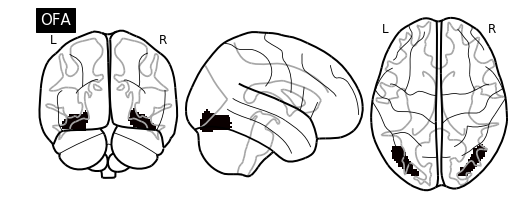

In [31]:
# plot
plotting.plot_glass_brain(OFAmask,
                                   #output_file=plotDir + 'rAmyg.png',
                                   display_mode='ortho',
                                   colorbar=False,
                                   #figure=f,
                                   axes=None,
                                   title='OFA',
                                   threshold='auto',#'auto', ##### careful: I chose a threshold of 20 here
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   #vmin=0,
                                   #vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

## ATL = aITG union with TP minus STG

most of the literature peaks for ATL face area fall within the aITG mask. However, the temporal pole is also under discussion for anterior face regions. We therefore create a union of temporal pole mask and aITG mask. To exclude other face regions that may fall withon those two regions (e.g. anterior STS face region), we exclude all voxels that are assicuated with the superior temporal gyrus (STG). This still leaves the temporal pole unaffected but cuts more posterior areas.

In [57]:
ATLmask = math_img(formula = ' ( aITG + TP ) > 0 ',
                    aITG = aITGmask, # threshold = 0 is the union of all masks, threshold = 1 is the intercection
                    TP = TPmask)
ATLmask = math_img(formula = '( ATL - STG ) > 0 ',
                    ATL = ATLmask, # threshold = 0 is the union of all masks, threshold = 1 is the intercection
                    STG = aSTGmask)
rATLmask = intersect_masks([ATLmask, rHemMask], threshold = 1)
lATLmask = intersect_masks([ATLmask, lHemMask], threshold = 1)

rATLmask.to_filename(maskDir + 'rATL.nii')
lATLmask.to_filename(maskDir + 'lATL.nii')
ATLmask.to_filename(maskDir + 'ATL.nii')

raITGmask1percent = intersect_masks([aITGmask1percent, rHemMask], threshold = 1)
laITGmask1percent = intersect_masks([aITGmask1percent, lHemMask], threshold = 1)
raITGmask1percent.to_filename(maskDir + 'raIT1percent')
laITGmask1percent.to_filename(maskDir + 'laIT1percent')


In [2]:
# plot
plotting.plot_glass_brain(raITGmask1percent,
                                   #output_file=plotDir + 'rAmyg.png',
                                   display_mode='ortho',
                                   colorbar=False,
                                   #figure=f,
                                   axes=None,
                                   title='right ATL mask, as an example',
                                   threshold='auto',#'auto', ##### careful: I chose a threshold of 20 here
                                   annotate=True,
                                   black_bg=False,
                                   cmap=None,
                                   alpha=1,
                                   #vmin=0,
                                   #vmax=1,
                                   plot_abs=True,
                                   symmetric_cbar='auto',
                                   resampling_interpolation='continuous'
                         )
plt.show()

NameError: name 'plotting' is not defined

# now overlay all the single subject t maps with the mask

In [60]:
# calculate the critical t value (for vizualization later)
from scipy import stats
import scipy.io as sio

SPMmatFile = 'C:/Users/Roman/Nextcloud/prosopagnosia/SPMmatFiles/01_03_SPM.mat'
SPMmat = sio.loadmat(SPMmatFile)
erdf = int(SPMmat['SPM'][0][0]['xX']['erdf'][0][0][0][0]) # the effective
           #degrees of freedom as calculated by SPM, taking into account serial autocorrelation of the individual subjects data

nComp = 1 # number of multiple comparisons for Bonferroni correction (optional)
df = erdf # 303
tails = 1
alpha = 0.05

def calculateCriticalT(df, alpha, tails, nComp):
    criticalT = stats.t.ppf(1 - alpha / tails / nComp, df)   #Studnt, n=304-->df=303, p<0.05, 2-tail
    #criticalT = (-criticalT, criticalT)
    return(criticalT)

criticalT = calculateCriticalT(df,alpha,tails,nComp)

In [61]:
criticalT

1.6478886100556485

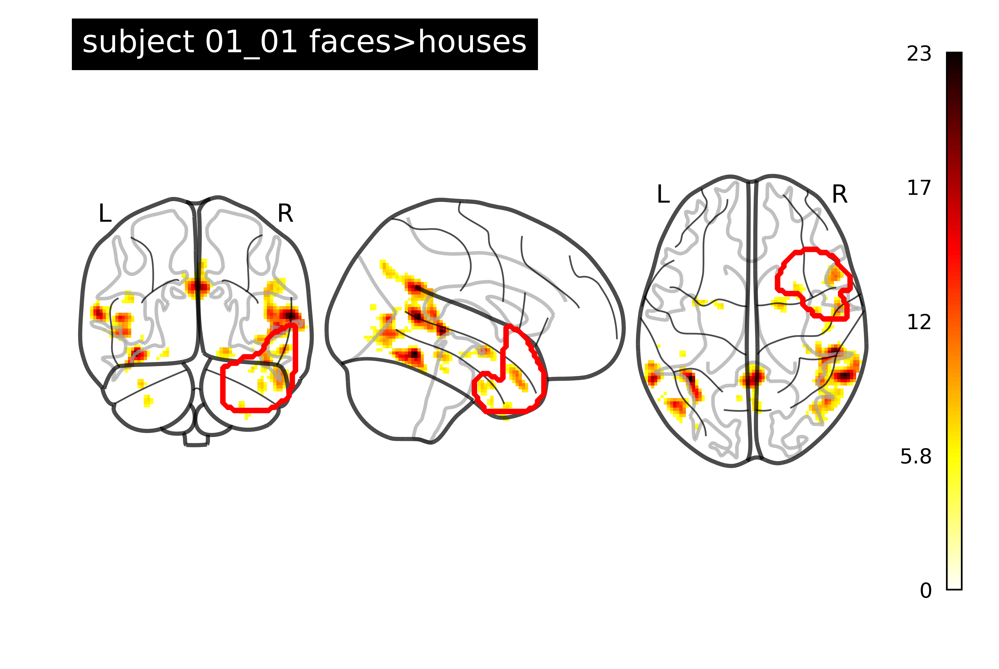

In [62]:
# test with 1 image and masks

testConFile = 'C:/Users/Roman/Nextcloud/prosopagnosia/spmTFiles/01_03_spmT_0002.nii'
testMaskFile = 'C:/Users/Roman/Desktop/Projects/Prosopagnosia/masks/romans_composition/rATL.nii'

from nilearn.image import load_img

import warnings
warnings.filterwarnings('ignore')

from nilearn.image import concat_imgs

allMasks = concat_imgs([maskDir + 'rOFA.nii',
                       maskDir + 'lOFA.nii',
                       maskDir + 'rFFA.nii',
                       maskDir + 'lFFA.nii',
                       maskDir + 'rATL.nii',
                       maskDir + 'lATL.nii',
                       maskDir + 'rAmy.nii',
                       maskDir + 'lAmy.nii',
                       ])

testCon = load_img(testConFile)
testMask = load_img(testMaskFile)

from nilearn.plotting import plot_stat_map, plot_glass_brain, plot_img, plot_roi
from nilearn.image import threshold_img

# threshold the image to exclude negative effects
#testCon2 = threshold_img(testCon, threshold=10) #criticalT
testConBin = math_img(formula = 'img>5', img = testCon) #criticalT
testCon2   = threshold_img(testCon, threshold = 5, mask_img=testConBin)

f = plt.figure(dpi=500)
# general stat map
display = plot_glass_brain(testCon2,
                display_mode = 'ortho',
                colorbar = True,
                #threshold = criticalT,
                annotate = True,
                plot_abs = False,
                symmetric_cbar = False,
                figure = f,
                title = 'subject 01_01 faces>houses')
display.add_contours(testMask, colors = 'red')

In [290]:
plt.figure?

In [296]:
# plot in a grid
# Grid of subplots
from nilearn.image import iter_img, index_img

fh = plt.figure(figsize=(10,30), dpi=1000)
for i, pi in enumerate(range(-45,15,3)):
    ax = fh.add_subplot(10, 3, i + 1)
    print(pi)
    display = plot_stat_map(testCon2,
                            axes=ax,
                            display_mode='z',
                            cut_coords=[pi],
                            colorbar = False,
                            #threshold = 1.5,
                            annotate = False)
    display.add_contours(load_img(maskDir + 'rOFA.nii'), filled=True, alpha=0.2, colors = 'green')
    display.add_contours(load_img(maskDir + 'lOFA.nii'), filled=True, alpha=0.2, colors = 'green')
    display.add_contours(load_img(maskDir + 'rFFA.nii'), filled=True, alpha=0.2, colors = 'blue')
    display.add_contours(load_img(maskDir + 'lFFA.nii'), filled=True, alpha=0.2, colors = 'blue')
    display.add_contours(load_img(maskDir + 'rATL.nii'), filled=True, alpha=0.2, colors = 'orange')
    display.add_contours(load_img(maskDir + 'lATL.nii'), filled=True, alpha=0.2, colors = 'orange')
    display.add_contours(load_img(maskDir + 'rAmy.nii'), filled=True, alpha=0.2, colors = 'black')
    display.add_contours(load_img(maskDir + 'lAmy.nii'), filled=True, alpha=0.2, colors = 'black')
    
    display.add_contours(mask3D, filled=True, alpha=0.2, colors = 'green')

display.savefig(plotDir + 'ROIs_over_activation_p05unc.pdf', dpi=1000)
display.savefig(plotDir + 'ROIs_over_activation_p05unc.png', dpi=1000)

#fh = plt.figure()
#for pi, img in enumerate(iter_img(index_img(maps_img, slice(None, 16)))):
#    ax = fh.add_subplot(4, 4, pi + 1)
#    plot_stat_map(img, axes=ax, display_mode='z', cut_coords=1)

-45
-42
-39
-36
-33
-30
-27
-24
-21
-18
-15
-12
-9
-6
-3
0
3
6
9
12


## search peak coordinates for all subjects

In [110]:
from glob import glob
import os
import nibabel as nib
import scipy.io as sio

#subDir = '' # to do
conFileDir = 'C:/Users/Roman/Nextcloud/prosopagnosia/spmTFiles/'
SPMFileDir = 'C:/Users/Roman/Nextcloud/prosopagnosia/SPMmatFiles/'

conFiles = sorted(glob(conFileDir + '*'))
SPMFiles = sorted(glob(SPMFileDir + '*'))

vois = ['lFFA','rFFA','lATL','rATL', 'raIT1percent','laIT1percent','lAmy','rAmy']


#os.chdir(subDir)
#subjects = sorted(subPattern)

# create empty lists of coordinates
coordinates = {}
for voi in vois:
    coordinates[voi] = []
coordinates['subject'] = []

for (conFile, SPMFile) in zip(conFiles, SPMFiles):
    
    conFile1 = load_img(conFile)
    #SPMFile1 = nib.load(SPMFile)
    

    ## plot tmap within masks/ROIs

    # a --> calc crit calue
    SPMmat = sio.loadmat(SPMFile)
    erdf = int(SPMmat['SPM'][0][0]['xX']['erdf'][0][0][0][0]) # the effective
               #degrees of freedom as calculated by SPM, taking into account serial autocorrelation of the individual subjects data

    nComp = 1 # number of multiple comparisons for Bonferroni correction (optional)
    df = erdf # 303
    tails = 1
    alpha = 0.05
    criticalT = calculateCriticalT(df,alpha,tails,nComp)
    print(criticalT)
    
    # because the following formula seems to need images as input, and the variable criticalT can not be parsed,
    # we calculate a criticalT dummy 3D file


    # b --> create thresholded tmap
    testConBin = math_img(formula = 'img>1.64788',
                          img = conFile1) #criticalT
    testCon2   = threshold_img(conFile1, threshold = criticalT,
                               mask_img=testConBin)
    
    # c --> plot
    '''
    from nilearn.image import iter_img, index_img

    fh = plt.figure(figsize=(10,30), dpi=1000)
    for i, pi in enumerate(range(-45,15,3)):
        ax = fh.add_subplot(7, 3, i + 1)
        print(pi)
        display = plot_stat_map(testCon2,
                                axes=ax,
                                display_mode='z',
                                cut_coords=[pi],
                                colorbar = False,
                                #threshold = 1.5,
                                annotate = False)
        #display.add_contours(load_img(maskDir + 'rOFA.nii'), filled=True, alpha=0.2, colors = 'green')
        #display.add_contours(load_img(maskDir + 'lOFA.nii'), filled=True, alpha=0.2, colors = 'green')
        display.add_contours(load_img(maskDir + 'rFFA.nii'), filled=True, alpha=0.2, colors = 'blue')
        display.add_contours(load_img(maskDir + 'lFFA.nii'), filled=True, alpha=0.2, colors = 'blue')
        display.add_contours(load_img(maskDir + 'rATL.nii'), filled=True, alpha=0.2, colors = 'orange')
        display.add_contours(load_img(maskDir + 'lATL.nii'), filled=True, alpha=0.2, colors = 'orange')
        display.add_contours(load_img(maskDir + 'raITGmask1percent.nii'), filled=True, alpha=0.2, colors = 'orange')
        display.add_contours(load_img(maskDir + 'laITGmask1percent.nii'), filled=True, alpha=0.2, colors = 'orange')
        display.add_contours(load_img(maskDir + 'rAmy.nii'), filled=True, alpha=0.2, colors = 'black')
        display.add_contours(load_img(maskDir + 'lAmy.nii'), filled=True, alpha=0.2, colors = 'black')

        display.savefig(plotDir + 'Tmaps_contours_' + os.path.normpath(conFile).split(os.sep)[-1][:5] + '_p05unc.pdf', dpi=1000)
        display.savefig(plotDir + 'Tmaps_contours_' + os.path.normpath(conFile).split(os.sep)[-1][:5] + '_p05unc.png', dpi=1000)
    '''
        # mask con with VOI        
        # find peak voxel in voi
    
    for voi in vois:
        mask = load_img(maskDir + voi + '.nii')
        #resampled_mask = resample_to_img( mask , conFile1 )
        resampled_con = resample_to_img( conFile1, mask)
        #coordinates[voi].append(find_xyz_cut_coords(conFile,
        #                                            mask_img=resampled_mask,
        #                                            activation_threshold=0))
        coordinates[voi].append(find_xyz_cut_coords(resampled_con,
                                                    mask_img=mask,
                                                    activation_threshold=criticalT))

    
    





1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.64788257711787
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6476237719403117
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.6478886100556485
1.647888610055

In [111]:
coordinates

{'lFFA': [[-40.656268065651716, -52.29136907658781, -21.21079190325878],
  [-41.394509369589144, -49.16396268596702, -17.729621243510366],
  [-37.733000080714845, -55.105392071468984, -16.313892753939577],
  [-41.94811614542954, -50.75325908597519, -16.522681274696488],
  [-46.33289359265558, -56.61707337241566, -18.60951905792136],
  [-40.93124408936458, -46.52527592783373, -21.393175362935835],
  [-33.840018060792886, -57.490054280369236, -17.403953739527417],
  [-42.12740835476711, -54.80075850396554, -17.795596276822053],
  [-36.70419298960954, -54.40077883222327, -21.240158479315],
  [-41.11530459817757, -54.78330360504508, -15.732391340117715],
  [-38.171615372525764, -46.507298101995346, -23.934456815599845],
  [-44.98316421922428, -59.54827722207942, -21.441866102848778],
  [-38.91081211345673, -63.06589613945576, -19.654471048332326],
  [-39.92069576206035, -53.69488184453695, -18.63771053500352],
  [-35.60178124780862, -58.17779394867486, -15.25748175483281],
  [-39.893023698

# plot the peak voxels within regions for all subjects

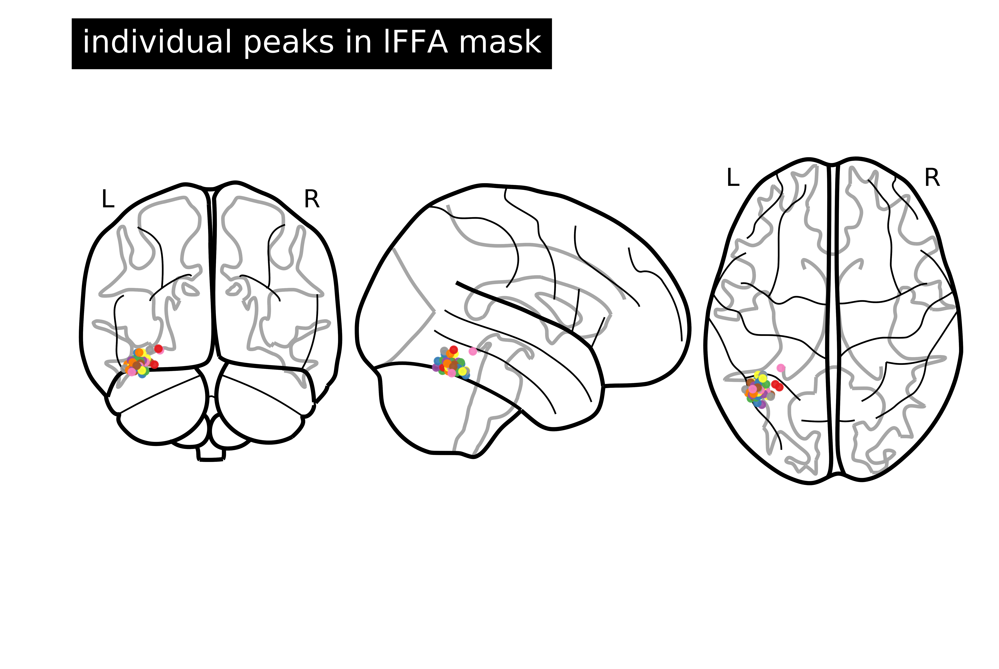

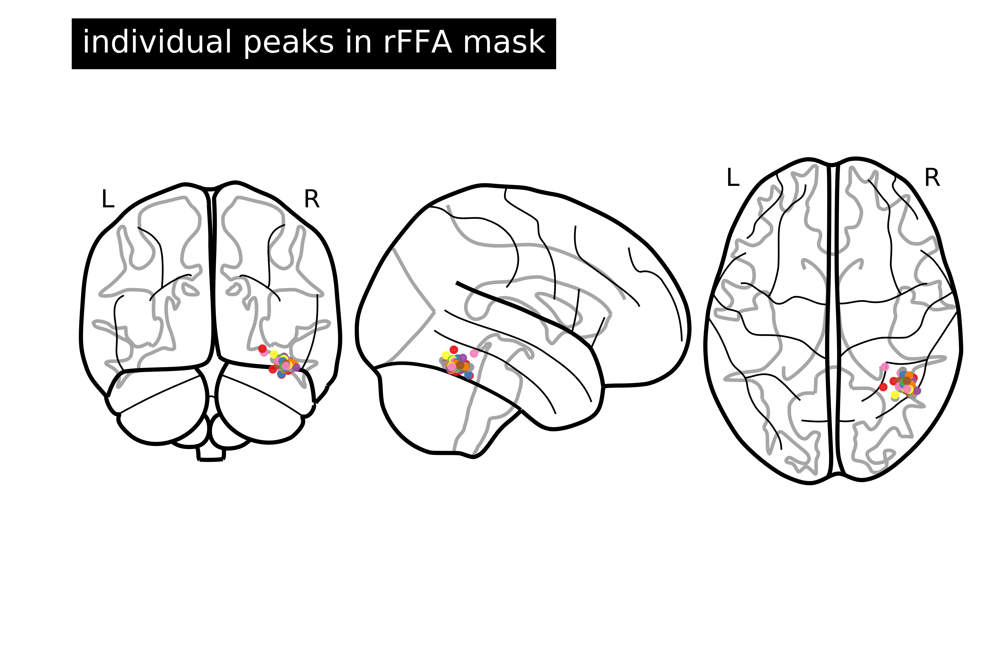

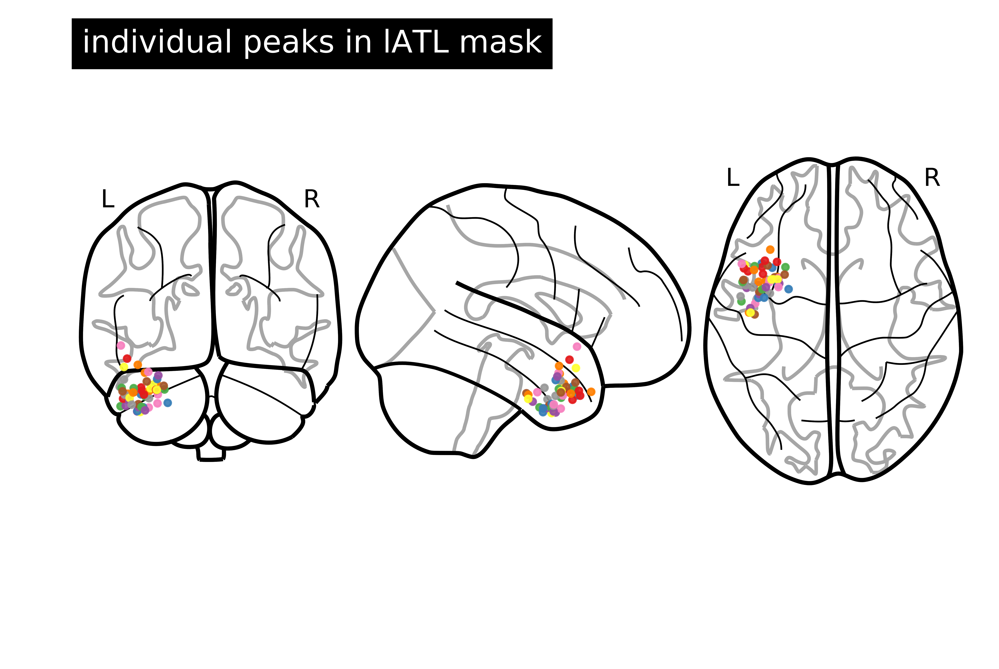

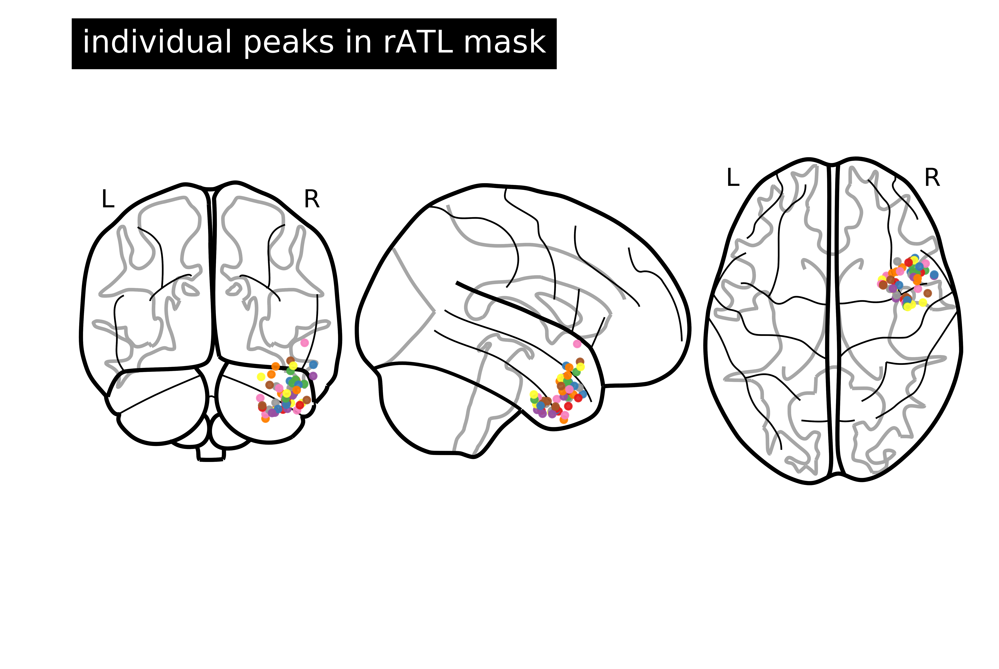

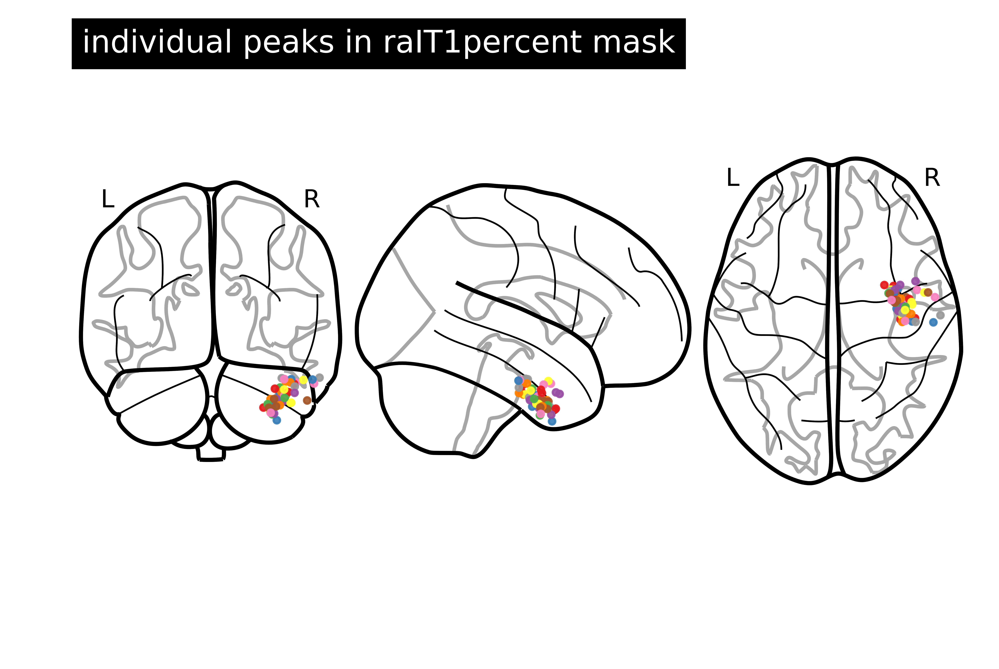

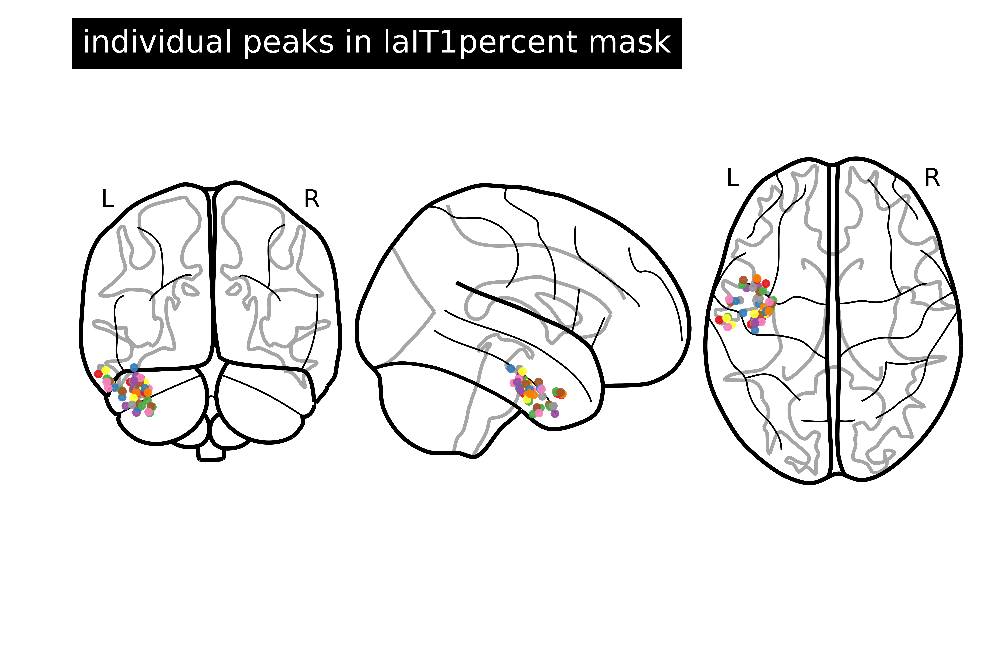

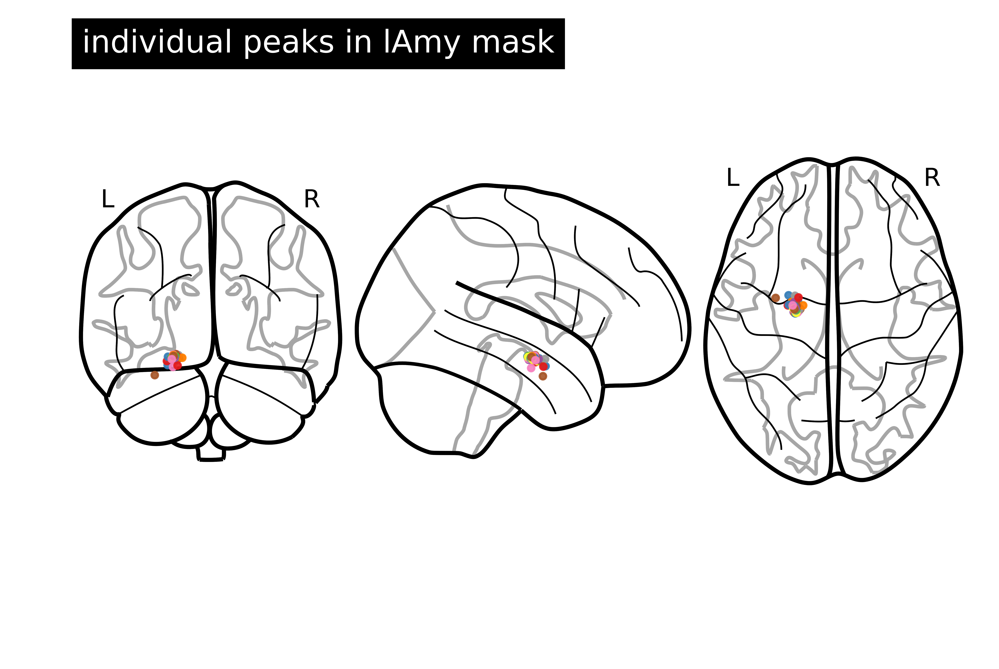

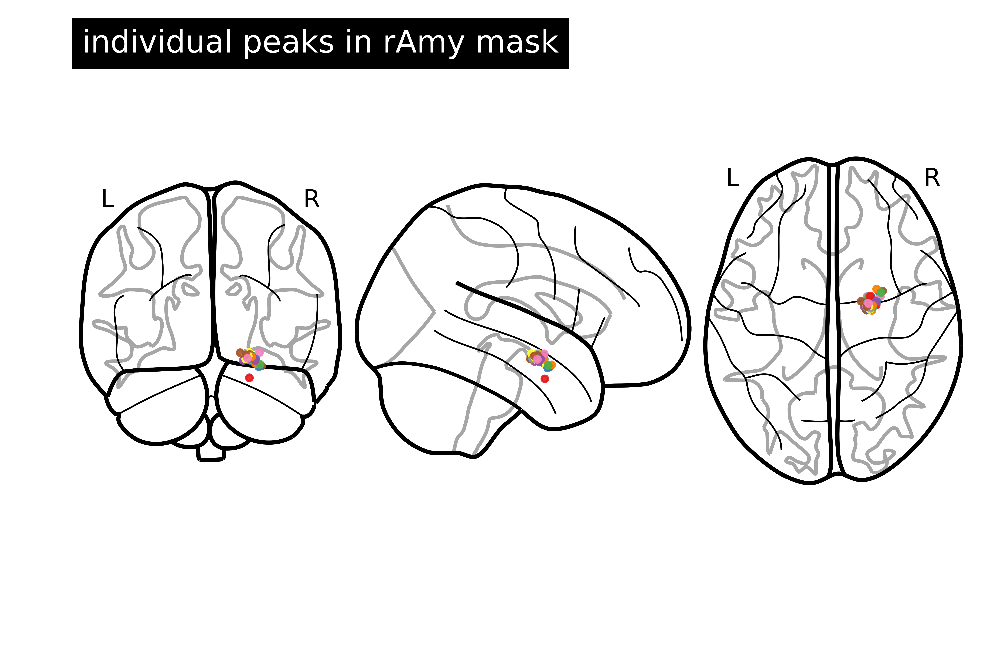

In [112]:
for voi in vois:
    Ncoords = len(coordinates[voi])
    
    f = plt.figure(dpi=1000)

    view = plotting.plot_connectome(adjacency_matrix=np.zeros((Ncoords,Ncoords)), # zero matrix, because we have no connectivities
                                                node_coords=coordinates[voi],
                                                display_mode='ortho',
                                                #cut_coords = list(range(-30,-10)),
                                                node_color =plt.cm.datad['Set1']['listed'],
                                                node_size = 10,
                                                node_kwargs = {'alpha': 0.9},
                                                title = 'individual peaks in ' + voi + ' mask', #subject + ' ' + region
                                                figure = f
                                               )

    plotting.plot_glass_brain(load_img(maskDir + voi + '.nii'), #image.index_img(atlas_filename,7),
                                       output_file=None,
                                       display_mode='ortho',
                                       #cut_coords = list(range(-30,-10)),
                                       colorbar=False,
                                       figure=f,
                                       axes=None,
                                       title=None,
                                       threshold=1,# 'auto',
                                       annotate=True,
                                       black_bg=False,
                                       cmap=None,
                                       alpha=1,
                                       vmin=1,
                                       vmax=1,
                                       plot_abs=True,
                                       symmetric_cbar='auto',
                                       resampling_interpolation='continuous'
                             )
    plt.show()


In [115]:
len(coordinates['raIT1percent'])

53

In [116]:
len(coordinates['laIT1percent'])

53

In [123]:
# implement with 1 test person
from nilearn.plotting import find_xyz_cut_coords
from nilearn.image import resample_to_img

resampled_testCon = resample_to_img(testConFile, rATLmask)

falureCoords = find_xyz_cut_coords(resampled_testCon,
                    mask_img=rATLmask,
                    activation_threshold=19)

In [124]:
falureCoords in coordinates['laIT1percent']

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [128]:
falureCoords.any(coordinates['laIT1percent'])

TypeError: 'list' object cannot be interpreted as an integer

In [131]:
coordinates['rAmy']

[[25.047264658402355, -7.363761589731396, -15.855504779450705],
 [23.357576770039458, -3.649451591047054, -16.88114653843681],
 [19.137173914367608, -5.2564035023780775, -14.831103963817391],
 [18.215369577783648, -8.07258569457079, -16.347415107913122],
 [22.666981450173935, -10.41787946604434, -14.941828038225566],
 [20.409792633201278, -6.177791223336058, -14.293734387270973],
 [28.58035254880913, 0.43581899386263956, -19.39105063869686],
 [20.01104769081519, -9.69976984987214, -13.306453862692585],
 [21.357673368741857, -3.8447585023883164, -16.025182313231298],
 [19.434094050908058, -10.121018704613846, -13.602193835334567],
 [20.707271727698867, -8.453186892937964, -14.148804022374478],
 [22.325251811698763, -7.206490042159871, -14.41861172820795],
 [19.28401334744973, -9.58065672477241, -13.424726272407952],
 [19.78724474529801, -5.715880101410448, -14.267128102615125],
 [26.820242745256323, -1.6406072129151426, -18.828694057180236],
 [19.601973874905624, -10.30120956242952, -15

In [ ]:
find_xyz_cut_coords